# about

evalutions of pseudobulk rna-seq samples

In [1]:
# gene quantification
ref_genome_tcga = "hg38"  # "hg19" or "hg38"
gene_units_tcga = "tpm"  # "tpm" or "counts"
# data quality
mets_only_tcga = True
gene_sparsity_ceiling_tcga = 0.5
# pseudobulk generation parameters
n_cells_per_cell_type = 10
malignant_from_one_sample = True

In [2]:
import pathlib

base = pathlib.Path("figures-8a")
figure_path = base / ";".join([f"ref_genome_tcga={ref_genome_tcga}", f"gene_units_tcga={gene_units_tcga}"])
figure_path.mkdir(parents=True, exist_ok=True)
figure_path

PosixPath('figures-8a/ref_genome_tcga=hg38;gene_units_tcga=tpm')

# imports

In [3]:
import logging

import helpers
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.io

In [4]:
handler = logging.StreamHandler()
formatter = logging.Formatter("%(asctime)s - %(name)s - %(levelname)s - %(message)s")
handler.setFormatter(formatter)
logging.getLogger().addHandler(handler)

In [5]:
logging.getLogger("gcsfs").setLevel("INFO")
logging.getLogger("google.cloud.bigquery").setLevel("DEBUG")
logging.getLogger("helpers").setLevel("DEBUG")
logging.getLogger("pandas").setLevel("DEBUG")
logging.getLogger("pyarrow").setLevel("DEBUG")

In [6]:
logger = logging.getLogger(__name__)
logger.setLevel("DEBUG")

In [7]:
rng = np.random.default_rng(seed=0)

# loading data

In [8]:
%%time
if ref_genome_tcga == "hg19" and gene_units_tcga == "tpm":
    bulk_tcga_skcm = helpers.datasets.load_tcga_skcm_hg19_scaled_estimate_firebrowse()
elif ref_genome_tcga == "hg19" and gene_units_tcga == "counts":
    bulk_tcga_skcm = helpers.datasets.load_tcga_skcm_hg19_normalized_counts_dereks_file()
elif ref_genome_tcga == "hg38" and gene_units_tcga == "tpm":
    bulk_tcga_skcm = helpers.datasets.load_tcga_skcm_hg38_fpkm_bigquery()
else:
    raise ValueError

2022-04-15 20:43:11,821 - helpers.datasets - DEBUG - loading TCGA SKCM bulk RNA-seq data from BigQuery
2022-04-15 20:43:11,823 - helpers.datasets - DEBUG - making query job
2022-04-15 20:43:13,365 - helpers.datasets - DEBUG - reading data from query to dataframe
Downloading: 100%|██████████| 9304064/9304064 [00:05<00:00, 1663242.20rows/s]
2022-04-15 20:43:34,038 - helpers.datasets - DEBUG - pivoting results


CPU times: user 11.5 s, sys: 2.26 s, total: 13.8 s
Wall time: 29.3 s


In [9]:
bulk_tcga_skcm

sample_id,TCGA-3N-A9WB-06A-11R-A38C-07,TCGA-3N-A9WC-06A-11R-A38C-07,TCGA-3N-A9WD-06A-11R-A38C-07,TCGA-BF-A1PU-01A-11R-A18S-07,TCGA-BF-A1PV-01A-11R-A18U-07,TCGA-BF-A1PX-01A-12R-A18T-07,TCGA-BF-A1PZ-01A-11R-A18S-07,TCGA-BF-A1Q0-01A-21R-A18S-07,TCGA-BF-A3DJ-01A-11R-A20F-07,TCGA-BF-A3DL-01A-11R-A20F-07,...,TCGA-XV-AB01-06A-12R-A40A-07,TCGA-YD-A89C-06A-11R-A37K-07,TCGA-YD-A9TA-06A-11R-A39D-07,TCGA-YD-A9TB-06A-12R-A40A-07,TCGA-YG-AA3N-01A-11R-A38C-07,TCGA-YG-AA3O-06A-11R-A38C-07,TCGA-YG-AA3P-06A-11R-A38C-07,TCGA-Z2-A8RT-06A-11R-A37K-07,TCGA-Z2-AA3S-06A-11R-A39D-07,TCGA-Z2-AA3V-06A-11R-A39D-07
gene_symbol,,,,,,,,,,,,,,,,,,,,,
A1BG,0.316945,0.152556,0.230553,0.158981,0.290790,0.142348,0.222355,0.277645,0.187224,0.112645,...,0.230860,0.142018,0.113168,0.272093,0.348701,0.345811,0.022653,0.232273,0.229432,0.238798
A1CF,0.000000,0.003978,0.003006,0.000000,0.000000,0.000000,0.001449,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.034970,0.000000,0.000000,0.001658,0.000000,0.001863,0.002945,0.002264
A2M,17.338106,1321.291406,124.667743,48.091445,15.678437,219.824082,24.354357,48.598480,2810.610503,49.716191,...,96.944393,151.027212,103.192914,215.388966,66.532300,290.924955,58.658701,169.931077,32.902727,251.845785
A2ML1,0.086929,0.010460,0.007904,0.127020,0.010358,20.824887,0.270623,0.100083,6.828529,0.011883,...,0.000000,0.015581,0.002299,0.011194,10.005256,0.054509,0.009320,0.019602,0.030979,0.002977
A3GALT2,0.018252,0.074675,0.056427,0.000000,0.000000,0.013936,0.013605,0.046596,0.134662,0.016966,...,0.000000,0.000000,0.164132,0.000000,0.042015,0.031130,0.000000,0.122442,0.055289,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZYG11B,3.842320,4.370333,4.615579,2.489354,6.708055,2.724972,4.473528,5.983165,5.619995,0.868009,...,0.643023,4.311933,5.937579,6.963782,2.886224,6.091135,5.155709,2.996880,10.473117,0.344766
ZYX,17.572519,53.575538,41.710301,67.484080,82.964259,58.895492,44.484107,152.540057,42.358971,81.067514,...,117.528759,72.599793,57.282269,47.762130,120.167701,46.150726,26.114543,41.024579,32.292355,118.110885
ZZEF1,1.960316,2.878303,3.141083,5.157699,3.939852,3.905660,5.091938,3.959793,4.073907,3.585307,...,3.334566,2.590584,4.236276,3.736214,6.090701,8.500123,4.290847,5.898542,5.459046,3.101429


In [10]:
%%time
fractions_tcga_skcm = helpers.datasets.load_tcga_skcm_fractions_from_csx()

2022-04-15 20:43:41,199 - helpers.datasets - DEBUG - loading TCGA SKCM fractions estimated by CIBERSORTx


CPU times: user 126 ms, sys: 15.4 ms, total: 141 ms
Wall time: 199 ms


In [11]:
%%time
sc_jerby_arnon, sc_metadata_jerby_arnon = helpers.datasets.load_jerby_arnon_hg19_tpm()

2022-04-15 20:43:41,407 - helpers.datasets - DEBUG - loading Jerby-Arnon scRNA-seq data
2022-04-15 20:44:33,754 - helpers.datasets - DEBUG - loading Jerby-Arnon metadata


CPU times: user 58.6 s, sys: 8.73 s, total: 1min 7s
Wall time: 52.4 s


In [12]:
# determine gene exclusions

exclusions_genes = pd.DataFrame(index=bulk_tcga_skcm.index.union(sc_jerby_arnon.index))

## sparsity in tcga
genes_sparse_tcga_skcm = bulk_tcga_skcm[(bulk_tcga_skcm == 0).mean(axis=1) > gene_sparsity_ceiling_tcga].index
exclusions_genes["sparse_in_tcga_skcm"] = exclusions_genes.index.map(lambda g: g in genes_sparse_tcga_skcm)

## genes not in both cohorts
genes_in_both = bulk_tcga_skcm.index.intersection(sc_jerby_arnon.index)
exclusions_genes["not_in_both_cohorts"] = exclusions_genes.index.map(lambda gene_name: gene_name not in genes_in_both)

good_genes = exclusions_genes.loc[~exclusions_genes.any(axis=1)].index

https://console.cloud.google.com/bigquery?authuser=1&project=keen-dispatch-316219

In [13]:
# determine tcga sample exclusions

exclusions_tcga_samples = pd.DataFrame(index=bulk_tcga_skcm.columns)

## limit to metastases

if mets_only_tcga:
    query_text = """
        SELECT aliquot_barcode
        FROM `keen-dispatch-316219.gdc_tcga_skcm_subset.aliquot2caseIDmap_current`
        WHERE sample_type_name = 'Metastatic'
    """
    metastatic_aliquot_barcodes = pd.read_gbq(query_text)["aliquot_barcode"].values
    exclusions_tcga_samples["is_not_metastatic"] = exclusions_tcga_samples.index.map(
        lambda sample: sample not in metastatic_aliquot_barcodes
    )

good_tcga_samples = exclusions_tcga_samples.loc[~exclusions_tcga_samples.any(axis=1)].index

In [14]:
# apply exclusions

print("before exclusions:", [df.shape for df in (sc_jerby_arnon, bulk_tcga_skcm, fractions_tcga_skcm)])
sc_jerby_arnon = sc_jerby_arnon.loc[good_genes]
bulk_tcga_skcm = bulk_tcga_skcm.loc[good_genes][good_tcga_samples]
fractions_tcga_skcm = fractions_tcga_skcm.loc[good_tcga_samples]
print("after exclusions:", [df.shape for df in (sc_jerby_arnon, bulk_tcga_skcm, fractions_tcga_skcm)])

before exclusions: [(23686, 7186), (19712, 472), (473, 9)]
after exclusions: [(16578, 7186), (16578, 367), (367, 9)]


In [15]:
# convert to units per million

bulk_tcga_skcm *= 1_000_000 / bulk_tcga_skcm.sum()
sc_jerby_arnon *= 1_000_000 / sc_jerby_arnon.sum()

In [16]:
# compute pseudobulks and their cell type GEPs

bulk_pseudo, bulk_pseudo_cell_type_geps = helpers.creating_mixtures.make_mixtures(
    sc_jerby_arnon,
    sc_metadata_jerby_arnon,
    fractions_tcga_skcm.rename(index=lambda sample: f"pseudo_like_{sample}"),
    n_cells_per_gep=n_cells_per_cell_type,
    normalization_factor=1_000_000,
    malignant_from_one_sample=malignant_from_one_sample,
    rng=rng,
)

2022-04-15 20:44:36,591 - helpers.creating_mixtures - DEBUG - using np.random.Generator with BitGenerator state {'state': 35399562948360463058890781895381311971, 'inc': 87136372517582989555478159403783844777}
2022-04-15 20:44:36,601 - helpers.creating_mixtures - DEBUG - randomly chose Mel79 for malignant cells
2022-04-15 20:44:36,674 - helpers.creating_mixtures - DEBUG - randomly chose Mel82 for malignant cells
2022-04-15 20:44:36,741 - helpers.creating_mixtures - DEBUG - randomly chose Mel129pa for malignant cells
2022-04-15 20:44:36,811 - helpers.creating_mixtures - DEBUG - randomly chose Mel78 for malignant cells
2022-04-15 20:44:36,879 - helpers.creating_mixtures - DEBUG - randomly chose Mel112 for malignant cells
2022-04-15 20:44:36,944 - helpers.creating_mixtures - DEBUG - randomly chose Mel89 for malignant cells
2022-04-15 20:44:37,008 - helpers.creating_mixtures - DEBUG - randomly chose Mel102 for malignant cells
2022-04-15 20:44:37,068 - helpers.creating_mixtures - DEBUG - ran

# figures

## mean dists

In [17]:
bulk_all = pd.concat({"tcga skcm": bulk_tcga_skcm, "pseudobulk": bulk_pseudo}, axis=1)
dfg = bulk_all.stack().groupby("gene_symbol")
log_means = np.log10(dfg.aggregate("mean") + 1e-2)
log_stddevs = np.log10(dfg.aggregate("std") + 1e-2)

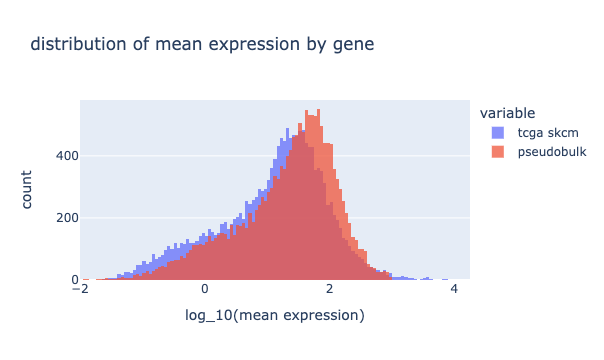

In [18]:
# df = pd.DataFrame({"tcga skcm": aggregate(bulk_tcga_skcm), "pseudobulks": aggregate(bulk_pseudo)})
title = "distribution of mean expression by gene"
x_axis_title = "log_10(mean expression)"
fig = px.histogram(log_means, title=title)
fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.75)
fig.update_xaxes(title=x_axis_title)

In [19]:
fig.write_image(figure_path / "mean_dist.png", width=800, height=500, scale=2)

### looking into very high expressed TCGA SKCM genes...

In [20]:
log_means.nlargest(10, columns=["tcga skcm"])

,tcga skcm,pseudobulk
gene_symbol,,
FTL,4.233064,2.962998
PMEL,3.954374,2.584820
TMSB10,3.889675,2.843786
ACTB,3.889515,2.951299
GAPDH,3.849674,3.001334
ACTG1,3.836715,2.915598
RPS12,3.664377,2.930422
RPS18,3.637773,2.979564
CD74,3.628003,2.422753


## stddev dists

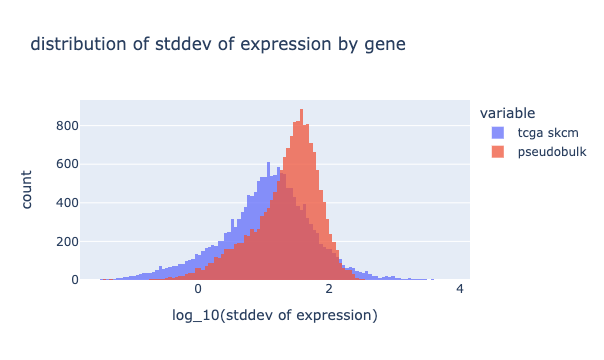

In [21]:
# df = pd.DataFrame({"tcga skcm": aggregate(bulk_tcga_skcm), "pseudobulks": aggregate(bulk_pseudo)})
title = "distribution of stddev of expression by gene"
x_axis_title = "log_10(stddev of expression)"
fig = px.histogram(log_stddevs, title=title)
fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.75)
fig.update_xaxes(title=x_axis_title)

In [22]:
fig.write_image(figure_path / "stddev_dist.png", width=800, height=500, scale=2)

## mean jointdist scatter

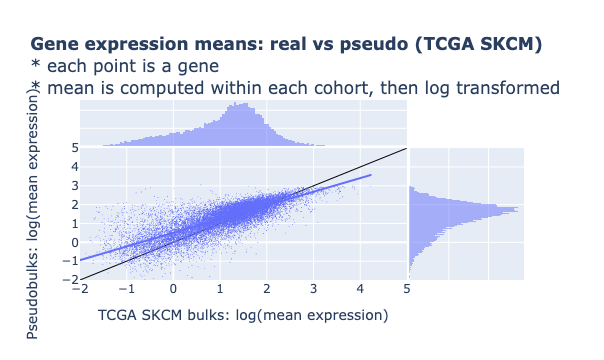

In [23]:
title = (
    "<b>Gene expression means: real vs pseudo (TCGA SKCM)</b>"
    "<br>* each point is a gene"
    "<br>* mean is computed within each cohort, then log transformed"
)
label_real, label_pseudo = "TCGA SKCM bulks", "pseudobulks"
axis_range = [-2, 5]

df = pd.DataFrame(
    {
        label_real: np.log10(bulk_tcga_skcm.mean(axis=1)),
        f"{label_real} sparsity": (bulk_tcga_skcm == 0).mean(axis=1),
        label_pseudo: np.log10(bulk_pseudo.mean(axis=1)),
        f"{label_pseudo} sparsity": (bulk_pseudo == 0).mean(axis=1),
    },
)

fig = px.scatter(
    df,
    x=label_real,
    y=label_pseudo,
    title=title,
    marginal_x="histogram",
    marginal_y="histogram",
    hover_name=df.index,
    hover_data=df.columns,
    trendline="ols",
)
fig.add_trace(
    go.Scatter(
        x=axis_range,
        y=axis_range,
        marker=dict(color="black"),
        line=dict(width=1),
        showlegend=False,
        mode="lines",
    ),
    row=1,
    col=1,
)
fig.update_traces(marker=dict(size=1), row=1, col=1)
fig.update_xaxes(
    title="TCGA SKCM bulks: log(mean expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
fig.update_yaxes(
    title="Pseudobulks: log(mean expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
# fig.show(height=800)

In [24]:
fig.write_image(figure_path / "mean_jointdist_scatter.png", width=800, height=700, scale=2)

## stddev jointdist scatter

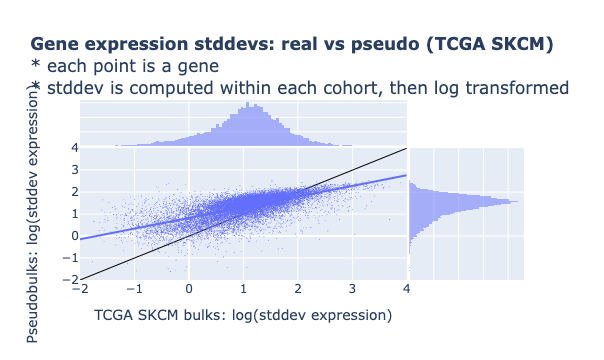

In [25]:
title = (
    "<b>Gene expression stddevs: real vs pseudo (TCGA SKCM)</b>"
    "<br>* each point is a gene"
    "<br>* stddev is computed within each cohort, then log transformed"
)
label_real, label_pseudo = "TCGA SKCM bulks", "pseudobulks"
axis_range = [-2, 4]

df = pd.DataFrame(
    {
        label_real: np.log10(bulk_tcga_skcm.std(axis=1)),
        f"{label_real} sparsity": (bulk_tcga_skcm == 0).mean(axis=1),
        label_pseudo: np.log10(bulk_pseudo.std(axis=1)),
        f"{label_pseudo} sparsity": (bulk_pseudo == 0).mean(axis=1),
    },
)

fig = px.scatter(
    df,
    x=label_real,
    y=label_pseudo,
    title=title,
    marginal_x="histogram",
    marginal_y="histogram",
    hover_name=df.index,
    hover_data=df.columns,
    trendline="ols",
)
fig.add_trace(
    go.Scatter(
        x=axis_range,
        y=axis_range,
        marker=dict(color="black"),
        line=dict(width=1),
        showlegend=False,
        mode="lines",
    ),
    row=1,
    col=1,
)
fig.update_traces(marker=dict(size=1), row=1, col=1)
fig.update_xaxes(
    title="TCGA SKCM bulks: log(stddev expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
fig.update_yaxes(
    title="Pseudobulks: log(stddev expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
fig.show(height=800)

In [26]:
fig.write_image(figure_path / "stddev_jointdist_scatter.png", width=800, height=700, scale=2)

## PCA

In [27]:
all_bulks = pd.concat(
    {"tcga skcm": bulk_tcga_skcm, "pseudobulks": bulk_pseudo}, axis=1, names=["sample_origin", helpers.columns.SAMPLE_ID]
).T

In [28]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(all_bulks)
all_bulks.values[:] = scaler.transform(all_bulks)

all_bulks.iloc[:, :5].agg(["mean", "std"])

gene_symbol,A1BG,A1CF,A2M,A2ML1,A4GALT
mean,1.936084e-16,3.872167e-16,5.033818e-16,3.097734e-16,-2.032888e-16
std,1.000682e+00,1.000682e+00,1.000682e+00,1.000682e+00,1.000682e+00


In [29]:
from sklearn.decomposition import PCA

n_components = 10

pca = PCA(n_components=n_components)
pca.fit(all_bulks)
pca_gene_eigenvectors = (
    pd.DataFrame(pca.components_, columns=all_bulks.columns, index=["PC " + str(i + 1) for i in range(n_components)])
    .rename_axis(index="PCs")
    .T
)
pca_plot_axis_labels = {str(i): f"PC {i+1}<br>({var:.1f}%)" for i, var in enumerate(pca.explained_variance_ratio_ * 100)}

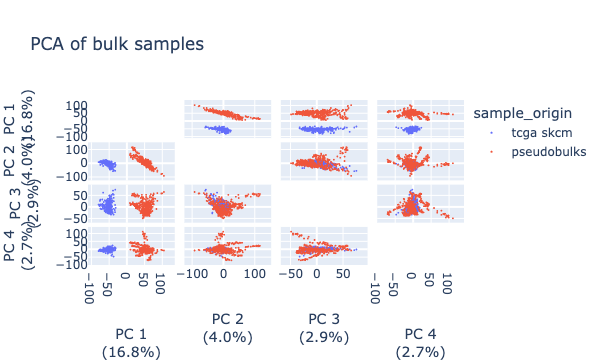

In [30]:
pca_coefficients_all_bulks = pd.DataFrame(pca.transform(all_bulks), index=all_bulks.index).reset_index()

fig = px.scatter_matrix(
    pca_coefficients_all_bulks,
    labels=pca_plot_axis_labels,
    dimensions=range(4),
    color="sample_origin",
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of bulk samples",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.show(height=800)
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.write_image(figure_path / "pca_4_samples.png", width=800, height=700, scale=2)

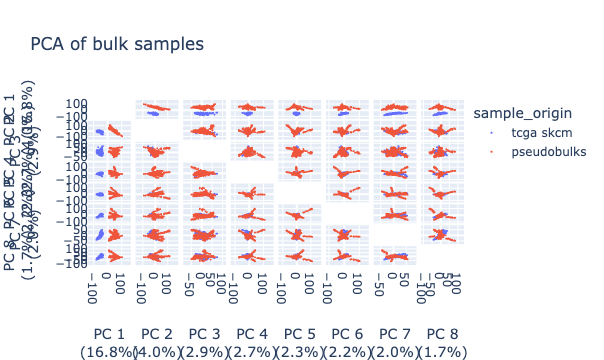

In [31]:
fig = px.scatter_matrix(
    pca_coefficients_all_bulks,
    labels=pca_plot_axis_labels,
    dimensions=range(8),
    color="sample_origin",
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of bulk samples",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.show(height=800)
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.write_image(figure_path / "pca_8_samples.png", width=800, height=700, scale=2)

### applied to pseudobulk cell type GEPs

In [32]:
pseudo_cell_type_geps = pd.concat(
    bulk_pseudo_cell_type_geps, axis=1, names=[helpers.columns.SAMPLE_ID, helpers.columns.CELL_TYPE]
).T
pseudo_cell_type_geps.values[:] = scaler.transform(pseudo_cell_type_geps)
pseudo_cell_type_geps.iloc[:, :5].agg(["mean", "std"])

gene_symbol,A1BG,A1CF,A2M,A2ML1,A4GALT
mean,-0.012749,2.147756,-0.431535,1.037678,0.553493
std,0.947486,3.193813,0.129473,1.184730,2.668502


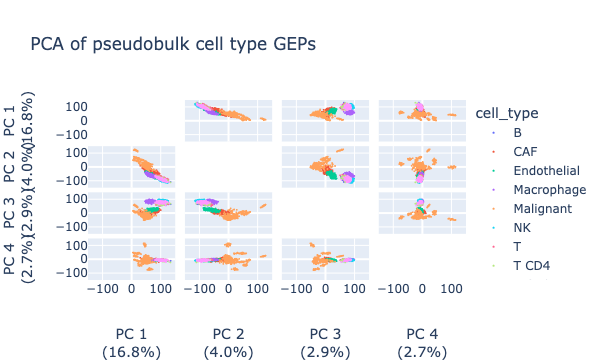

In [33]:
pca_coefficients_pseudo_cell_type_geps = pd.DataFrame(
    pca.transform(pseudo_cell_type_geps), index=pseudo_cell_type_geps.index
).reset_index()

fig = px.scatter_matrix(
    pca_coefficients_pseudo_cell_type_geps,
    labels=pca_plot_axis_labels,
    dimensions=range(4),
    color=helpers.columns.CELL_TYPE,
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of pseudobulk cell type GEPs",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.show(height=800)
fig.write_image(figure_path / "pca_4_pseudo_cell_type_geps.png", width=800, height=700, scale=2)

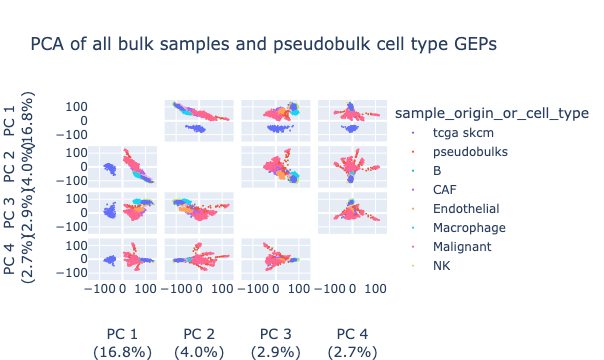

In [34]:
pca_coefficients_bulks_and_geps = pd.concat([pca_coefficients_all_bulks, pca_coefficients_pseudo_cell_type_geps])
pca_coefficients_bulks_and_geps["sample_origin_or_cell_type"] = pca_coefficients_bulks_and_geps["sample_origin"].fillna(
    pca_coefficients_bulks_and_geps["cell_type"]
)

fig = px.scatter_matrix(
    pca_coefficients_bulks_and_geps,
    labels=pca_plot_axis_labels,
    dimensions=range(4),
    color="sample_origin_or_cell_type",
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of all bulk samples and pseudobulk cell type GEPs",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.write_image(figure_path / "pca_4_bulks_and_geps.png", width=800, height=700, scale=2)
fig.show(height=1000, width=800)

### first PC

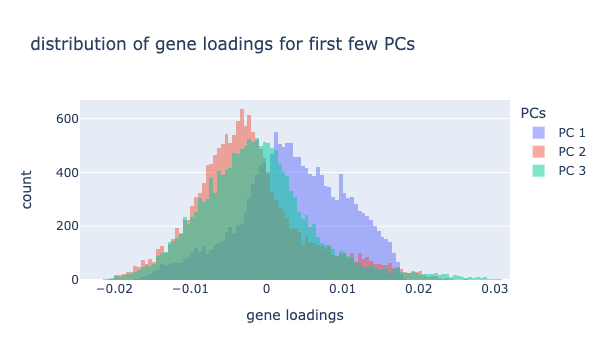

In [35]:
title = "distribution of gene loadings for first few PCs"
fig = px.histogram(pca_gene_eigenvectors.iloc[:, :3], title=title)
fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.5)
fig.update_xaxes(title="gene loadings")

In [36]:
gene_features = pca_gene_eigenvectors.iloc[:, :3]
gene_features["sparse_rate_bulk_tcga_skcm"] = (bulk_tcga_skcm == 0).mean(axis=1)
gene_features["sparse_rate_sc_jerby_arnon"] = (sc_jerby_arnon == 0).mean(axis=1)
gene_features["mean_bulk_tcga_skcm"] = bulk_tcga_skcm.mean(axis=1)
gene_features["stddev_bulk_tcga_skcm"] = bulk_tcga_skcm.std(axis=1)
gene_features["mean_sc_jerby_arnon"] = sc_jerby_arnon.mean(axis=1)
gene_features["stddev_sc_jerby_arnon"] = sc_jerby_arnon.std(axis=1)

In [37]:
gene_features.corr(
    # method="spearman"
)

PCs,PC 1,PC 2,PC 3,sparse_rate_bulk_tcga_skcm,sparse_rate_sc_jerby_arnon,mean_bulk_tcga_skcm,stddev_bulk_tcga_skcm,mean_sc_jerby_arnon,stddev_sc_jerby_arnon
PCs,,,,,,,,,
PC 1,1.000000,0.147121,0.072563,-0.025931,-0.453622,-0.222202,-0.201995,0.162187,0.238999
PC 2,0.147121,1.000000,-0.042091,-0.000407,-0.044175,0.069994,0.031261,0.215244,0.236640
PC 3,0.072563,-0.042091,1.000000,0.082786,-0.052772,0.018268,0.040998,0.151902,0.143901
sparse_rate_bulk_tcga_skcm,-0.025931,-0.000407,0.082786,1.000000,0.236547,-0.077350,-0.050028,-0.187617,-0.345698
sparse_rate_sc_jerby_arnon,-0.453622,-0.044175,-0.052772,0.236547,1.000000,-0.230762,-0.138290,-0.692620,-0.624016
mean_bulk_tcga_skcm,-0.222202,0.069994,0.018268,-0.077350,-0.230762,1.000000,0.882689,0.512783,0.356746
stddev_bulk_tcga_skcm,-0.201995,0.031261,0.040998,-0.050028,-0.138290,0.882689,1.000000,0.358549,0.264312
mean_sc_jerby_arnon,0.162187,0.215244,0.151902,-0.187617,-0.692620,0.512783,0.358549,1.000000,0.813568
stddev_sc_jerby_arnon,0.238999,0.236640,0.143901,-0.345698,-0.624016,0.356746,0.264312,0.813568,1.000000


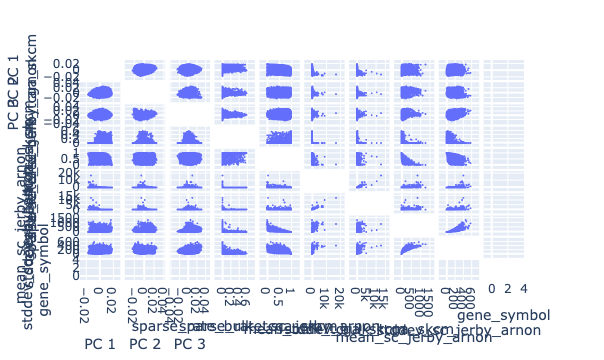

In [38]:
fig = px.scatter_matrix(gene_features, hover_name=gene_features.index)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.show(height=800)
fig.write_image(figure_path / "gene_features_scatter_matrix.png", width=800, height=700, scale=2)

In [39]:
gene_features.sort_values(by="PC 1", ascending=False)

PCs,PC 1,PC 2,PC 3,sparse_rate_bulk_tcga_skcm,sparse_rate_sc_jerby_arnon,mean_bulk_tcga_skcm,stddev_bulk_tcga_skcm,mean_sc_jerby_arnon,stddev_sc_jerby_arnon
gene_symbol,,,,,,,,,
METTL21A,0.018291,-0.002822,0.001375,0.000000,0.010715,9.658722,3.825509,414.702794,201.494079
ASTN2,0.018209,-0.001195,0.001903,0.000000,0.010854,8.240914,20.772171,530.052578,263.674013
ORC4,0.018156,-0.000977,0.002135,0.000000,0.011968,13.386410,5.914545,450.976025,228.779356
ODF2L,0.018147,-0.003568,0.002002,0.000000,0.014194,8.766126,5.622705,398.440722,208.934996
SHISA9,0.017992,-0.004251,0.001128,0.378747,0.014055,0.469067,3.377039,413.893553,223.165320
...,...,...,...,...,...,...,...,...,...
SCAF1,-0.016626,-0.004702,-0.002133,0.000000,0.919566,110.187030,39.225389,6.274458,34.670487
U2AF2,-0.016774,-0.006348,-0.004341,0.000000,0.812970,217.104988,63.234471,20.499898,68.266685
NACC1,-0.016848,-0.005668,-0.001487,0.000000,0.941692,98.677651,33.171244,4.211859,30.016909


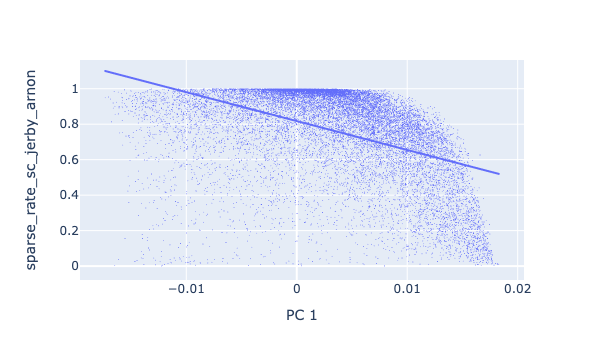

In [40]:
fig = px.scatter(
    gene_features,
    x="PC 1",
    y="sparse_rate_sc_jerby_arnon",
    trendline="ols",
)
fig.update_traces(marker=dict(size=1))

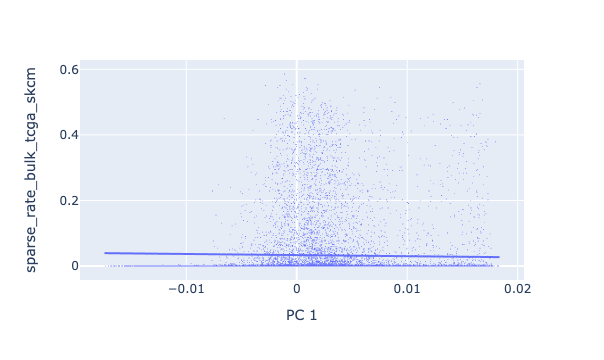

In [41]:
fig = px.scatter(
    gene_features,
    x="PC 1",
    y="sparse_rate_bulk_tcga_skcm",
    trendline="ols",
)
fig.update_traces(marker=dict(size=1))

In [42]:
pca_gene_eigenvectors["PC 1"].nlargest(10)

gene_symbol
METTL21A    0.018291
ASTN2       0.018209
ORC4        0.018156
ODF2L       0.018147
SHISA9      0.017992
CFLAR       0.017858
GOSR1       0.017740
SPC25       0.017727
LPP         0.017720
L2HGDH      0.017710
Name: PC 1, dtype: float64

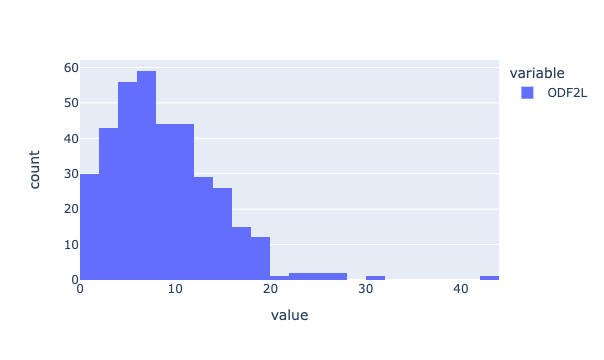

In [43]:
px.histogram(bulk_tcga_skcm.loc["ODF2L"])

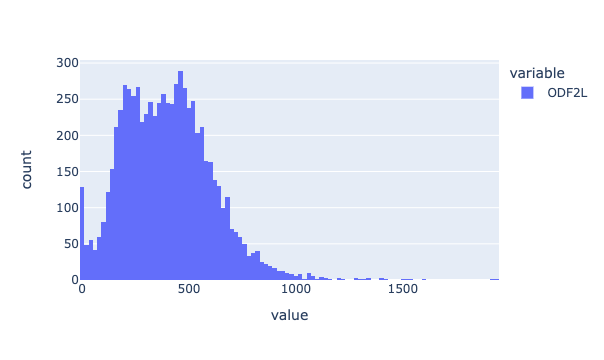

In [44]:
px.histogram(sc_jerby_arnon.loc["ODF2L"])